In [1]:
import numpy as np
import cv2
from pathlib import Path
from typing import List, Tuple
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
from tqdm import tqdm
import pandas as pd
import pickle
from PIL import Image
import math

In [2]:
def compute_euclidean_distance(hist1: np.ndarray, hist2: np.ndarray) -> np.float64:
    """Compute the Euclidean (L2) distance between two histograms.

    Args:
        hist1 (np.ndarray): First histogram.
        hist2 (np.ndarray): Second histogram.

    Returns:
        np.float64: Euclidean distance between the two histograms.
    """
    return np.sqrt(np.sum(np.square(hist1 - hist2)))


def compute_l1_distance(hist1: np.ndarray, hist2: np.ndarray) -> np.float64:
    """Compute the L1 (Manhattan) distance between two histograms.

    Args:
        hist1 (np.ndarray): First histogram.
        hist2 (np.ndarray): Second histogram.

    Returns:
        np.float64: L1 distance between the two histograms.
    """
    return np.sum(np.abs(hist1 - hist2))

def compute_chi_2_distance(hist1: np.ndarray, hist2: np.ndarray) -> np.float64:
    """Compute the Chi-squared distance between two histograms.

    Args:
        hist1 (np.ndarray): First histogram.
        hist2 (np.ndarray): Second histogram.

    Returns:
        np.float64: Chi-squared distance between the two histograms.
    """
    # Add a small epsilon to avoid division by zero
    epsilon = 1e-10
    return np.sum(((hist1 - hist2) ** 2) / (hist1 + hist2 + epsilon))

def compute_histogram_intersection(hist1: np.ndarray, hist2: np.ndarray) -> np.float64:
    """Compute the histogram intersection between two histograms.

    Args:
        hist1 (np.ndarray): First histogram.
        hist2 (np.ndarray): Second histogram.

    Returns:
        np.float64: Histogram intersection value between the two histograms.
    """
    intersection = np.sum(np.minimum(hist1, hist2))
    return 1.0 - intersection


def compute_hellinger_kernel(hist1: np.ndarray, hist2: np.ndarray) -> np.float64:
    """Compute the Hellinger kernel
    between two normalized histograms.

    Args:
        hist1 (np.ndarray): First histogram (should be L1-normalized).
        hist2 (np.ndarray): Second histogram (should be L1-normalized).

    Returns:
        np.float64: Hellinger kernel similarity (1 = identical, 0 = no overlap).
    """
    return np.sqrt(0.5 * np.sum((np.sqrt(hist1) - np.sqrt(hist2)) ** 2))


def compute_cosine_similarity(hist1: np.ndarray, hist2: np.ndarray) -> np.float64:
    """Compute the Cosine similarity between two histograms.

    Args:
        hist1 (np.ndarray): First histogram.
        hist2 (np.ndarray): Second histogram.

    Returns:
        np.float64: Cosine similarity (1 = identical, 0 = orthogonal).
    """
    dot_product = np.dot(hist1, hist2)
    norm1 = np.linalg.norm(hist1)
    norm2 = np.linalg.norm(hist2)
    epsilon = 1e-10
    cosine_sim = dot_product / (norm1 * norm2 + epsilon)
    return 1.0 - cosine_sim

def canberra_distance(hist1: np.ndarray, hist2: np.ndarray) -> float:
    """
    Code for Canberra distance between two histograms.
    Weighted version of L1 distance, sensitive to small changes near zero.
    """
    epsilon = 1e-10
    numerator = np.abs(hist1 - hist2)
    denominator = np.abs(hist1) + np.abs(hist2) + epsilon
    return np.sum(numerator / denominator)

def bhattacharyya_distance(hist1: np.ndarray, hist2: np.ndarray) -> float:
    """Code for Bhattacharyya distance"""
    bc = np.sum(np.sqrt(hist1 * hist2))
    return -np.log(bc + 1e-10)


def jeffrey_divergence(hist1: np.ndarray, hist2: np.ndarray) -> float:
    """
    Code for Jeffrey divergence (symmetric version of KL divergence).
    Also known as Jensen-Shannon divergence.
    """
    epsilon = 1e-10
    hist1_safe = hist1 + epsilon
    hist2_safe = hist2 + epsilon
    
    # Jeffrey divergence = KL(hist1 || m) + KL(hist2 || m)
    # where m = (hist1 + hist2) / 2
    m = (hist1_safe + hist2_safe) / 2
    
    kl1 = np.sum(hist1_safe * np.log(hist1_safe / m))
    kl2 = np.sum(hist2_safe * np.log(hist2_safe / m))
    
    return (kl1 + kl2) / 2

def correlation_distance(hist1: np.ndarray, hist2: np.ndarray) -> float:
    """
    Code for Correlation distance (1 - correlation coefficient).
    Measures linear relationship between histograms.
    """
    # Pearson correlation coefficient
    hist1_centered = hist1 - np.mean(hist1)
    hist2_centered = hist2 - np.mean(hist2)
    
    numerator = np.sum(hist1_centered * hist2_centered)
    denominator = np.sqrt(np.sum(hist1_centered**2) * np.sum(hist2_centered**2))
    
    if denominator < 1e-10:
        return 1.0  # Completely uncorrelated
    
    correlation = numerator / denominator
    return 1.0 - correlation

In [3]:
def convert_img_to_gray_scale(img: np.ndarray) -> np.ndarray:
    """Convert a BGR image to grayscale.

    Args:
        img (np.ndarray): Input image in BGR format.

    Returns:
        np.ndarray: Grayscale image.
    """
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img_gray


def compute_histogram(
    img: np.ndarray,
    values_per_bin: int = 1,
    density: bool = True
) -> Tuple[np.ndarray, np.ndarray]:
    """Compute the histogram of a grayscale image with adjustable bin size.

    Args:
        img (np.ndarray): Input grayscale image.
        values_per_bin (int, optional): Number of consecutive intensity values 
            grouped into each bin. For example, 1 creates 256 bins 
            (0–255 individually), 2 creates 128 bins (0–1, 2–3, ...). 
            Must be >= 1. Defaults to 1.
        density (bool, optional): If True, normalize the histogram so the 
            total area equals 1. If False, return raw counts. Defaults to True.

    Returns:
        Tuple[np.ndarray, np.ndarray]: 
            - Histogram values (counts or normalized probabilities).
            - Bin edges corresponding to the histogram.

    Raises:
        ValueError: If `values_per_bin` is less than 1 or larger than 256.
    """
    if (values_per_bin < 1) or (values_per_bin > 256):
        raise ValueError("values_per_bin must be >= 1 and <=256")

    bins = math.ceil(256 / values_per_bin)
    max_range = bins * values_per_bin

    hist, bin_edges = np.histogram(
        img, bins=bins, range=[0, max_range], density=density)
    return hist, bin_edges


def compute_grayscale_histogram(img_path: str, values_per_bin: int = 1) -> np.ndarray:
    """
    Compute grayscale histogram from image path.
    
    Args:
        img_path (str): Path to the image file.
        values_per_bin (int): Number of intensity values per bin.
        
    Returns:
        np.ndarray: Normalized histogram.
    """
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        raise ValueError(f"Could not load image from {img_path}")
    
    # Convert to grayscale
    img_gray = convert_img_to_gray_scale(img)
    
    # Compute histogram
    hist, _ = compute_histogram(img_gray, values_per_bin=values_per_bin, density=True)
    
    return hist

def compute_rgb_histogram(img_path: str, values_per_bin: int = 1) -> np.ndarray:
    """
    Compute RGB concatenated histogram from image path.
    
    Args:
        img_path (str): Path to the image file.
        values_per_bin (int): Number of intensity values per bin.
        
    Returns:
        np.ndarray: Normalized concatenated RGB histogram.
    """
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        raise ValueError(f"Could not load image from {img_path}")
    
    # Convert BGR to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Compute histogram for each channel
    histograms = []
    for i in range(3):  # R, G, B
        channel = img_rgb[:, :, i]
        hist, _ = compute_histogram(channel, values_per_bin=values_per_bin, density=True)
        histograms.append(hist)
    
    # Concatenate histograms
    concat_hist = np.concatenate(histograms)
    
    return concat_hist

def compute_hsv_histogram(img_path: str, values_per_bin: int = 1) -> np.ndarray:
    """
    Compute HSV concatenated histogram from image path.
    
    Args:
        img_path (str): Path to the image file.
        values_per_bin (int): Number of intensity values per bin.
        
    Returns:
        np.ndarray: Normalized concatenated HSV histogram.
    """
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        raise ValueError(f"Could not load image from {img_path}")
    
    # Convert BGR to HSV
    img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    
    # Compute histogram for each channel
    histograms = []
    for i in range(3):  # H, S, V
        channel = img_hsv[:, :, i]
        hist, _ = compute_histogram(channel, values_per_bin=values_per_bin, density=True)
        histograms.append(hist)
    
    # Concatenate histograms
    concat_hist = np.concatenate(histograms)
    
    return concat_hist

def compute_ycbcr_histogram(img_path: str, values_per_bin: int = 1) -> np.ndarray:
    """
    Compute YCbCr concatenated histogram from image path.
    
    Args:
        img_path (str): Path to the image file.
        values_per_bin (int): Number of intensity values per bin.
        
    Returns:
        np.ndarray: Normalized concatenated YCbCr histogram.
    """
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        raise ValueError(f"Could not load image from {img_path}")
    
    # Convert BGR to YCbCr
    img_ycbcr = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    
    # Compute histogram for each channel
    histograms = []
    for i in range(3):  # Y, Cb, Cr
        channel = img_ycbcr[:, :, i]
        hist, _ = compute_histogram(channel, values_per_bin=values_per_bin, density=True)
        histograms.append(hist)
    
    # Concatenate histograms
    concat_hist = np.concatenate(histograms)
    
    return concat_hist

def compute_lab_histogram(img_path: str, values_per_bin: int = 1) -> np.ndarray:
    """
    Compute LAB concatenated histogram from image path.
    
    Args:
        img_path (str): Path to the image file.
        values_per_bin (int): Number of intensity values per bin.
        
    Returns:
        np.ndarray: Normalized concatenated LAB histogram.
    """
    # Load image
    img = cv2.imread(img_path)
    if img is None:
        raise ValueError(f"Could not load image from {img_path}")
    
    # Convert BGR to LAB
    img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    
    # Compute histogram for each channel
    histograms = []
    for i in range(3):  # L, A, B
        channel = img_lab[:, :, i]
        hist, _ = compute_histogram(channel, values_per_bin=values_per_bin, density=True)
        histograms.append(hist)
    
    # Concatenate histograms
    concat_hist = np.concatenate(histograms)
    
    return concat_hist

In [ ]:
class ImageRetrievalSystem:
    def __init__(self, museum_dir: str, distance_metric: str = 'compute_chi_2_distance', 
                 descriptor_type: str = 'grayscale', values_per_bin: int = 1):
        """
        Initialize retrieval system.
        
        Args:
            museum_dir: Directory with museum images
            distance_metric: Distance function name
            descriptor_type: Type of histogram descriptor ('rgb', 'hsv', 'ycbcr', 'lab', 'cielab', 'grayscale')
            values_per_bin: Number of intensity values per histogram bin
        """
        self.museum_dir = Path(museum_dir)
        self.distance_metric = distance_metric
        self.descriptor_type = descriptor_type
        self.values_per_bin = values_per_bin
        
        # Distance functions
        self.distance_functions = {
            'euclidean_distance': compute_euclidean_distance,
            'compute_l1_distance': compute_l1_distance,
            'compute_chi_2_distance': compute_chi_2_distance,
            'compute_histogram_intersection': compute_histogram_intersection,
            'hellinger_kernel': compute_hellinger_kernel,
            'compute_cosine_similarity': compute_cosine_similarity,
            'canberra_distance': canberra_distance,
            'bhattacharyya_distance': bhattacharyya_distance,
            'jeffrey_divergence': jeffrey_divergence,
            'correlation_distance': correlation_distance
        }
        
        # Histogram descriptor functions
        self.descriptor_functions = {
            'rgb': compute_rgb_histogram,
            'hsv': compute_hsv_histogram,
            'ycbcr': compute_ycbcr_histogram,
            'lab': compute_lab_histogram,
            'grayscale': compute_grayscale_histogram
        }
        
        # Load museum database
        self.museum_images = sorted(self.museum_dir.glob('*.jpg'))
        self.museum_histograms = {}
        self._build_database()
    
    def _extract_museum_id(self, filename: str) -> int:
        """Extract integer museum ID from filename."""
        stem = Path(filename).stem
        if stem.startswith('bbdd_'):
            stem = stem[5:]
        return int(stem)
    
    def _build_database(self):
        """Pre-compute histograms for all museum images."""
        print(f"Building BBDD database ({self.descriptor_type}, {self.distance_metric}, bins_per_value={self.values_per_bin})...")
        
        descriptor_func = self.descriptor_functions[self.descriptor_type]
        
        for img_path in tqdm(self.museum_images):
            hist = descriptor_func(str(img_path), values_per_bin=self.values_per_bin)
            museum_id = self._extract_museum_id(img_path.name)
            self.museum_histograms[museum_id] = hist
    
    def retrieve(self, query_image_path: str, k: int = 5):
        """Retrieve top-k similar images."""
        descriptor_func = self.descriptor_functions[self.descriptor_type]
        query_hist = descriptor_func(query_image_path, values_per_bin=self.values_per_bin)
        
        distance_func = self.distance_functions[self.distance_metric]
        
        distances = []
        for museum_id, museum_hist in self.museum_histograms.items():
            dist = distance_func(query_hist, museum_hist)
            distances.append((museum_id, dist))
        
        distances.sort(key=lambda x: x[1])
        return distances[:k]

In [5]:
def apk(actual, predicted, k=10):
    """
    Computes the average precision at k.

    This function computes the average prescision at k between two lists of
    items.

    Parameters
    ----------
    actual : list
             A list of elements that are to be predicted (order doesn't matter)
    predicted : list
                A list of predicted elements (order does matter)
    k : int, optional
        The maximum number of predicted elements

    Returns
    -------
    score : double
            The average precision at k over the input lists

    """
    if len(predicted)>k:
        predicted = predicted[:k]

    score = 0.0
    num_hits = 0.0

    for i,p in enumerate(predicted):
        if p in actual and p not in predicted[:i]:
            num_hits += 1.0
            score += num_hits / (i+1.0)

    if not actual:
        return 0.0

    return score / min(len(actual), k)

def mapk(actual, predicted, k=10):
    """
    Computes the mean average precision at k.

    This function computes the mean average prescision at k between two lists
    of lists of items.

    Parameters
    ----------
    actual : list
             A list of lists of elements that are to be predicted 
             (order doesn't matter in the lists)
    predicted : list
                A list of lists of predicted elements
                (order matters in the lists)
    k : int, optional
        The maximum number of predicted elements

    Returns
    -------
    score : double
            The mean average precision at k over the input lists

    """
    return np.mean([apk(a,p,k) for a,p in zip(actual, predicted)])

def evaluate_all_descriptors_and_distances(qsd1_dir: str, museum_dir: str, 
                                          ground_truth_pickle: str, values_per_bin: int = 1,
                                          k_values: List[int] = [1, 5]):
    """
    Evaluate all combinations of descriptors and distance metrics.
    """
    qsd1_path = Path(qsd1_dir)
    query_images = sorted(qsd1_path.glob('*.jpg'))
    
    # Load ground truth
    with open(ground_truth_pickle, 'rb') as f:
        ground_truth = pickle.load(f)
    
    print(f"Loaded ground truth: {len(ground_truth)} entries")
    
    # Define descriptors and distance metrics
    descriptors = ['rgb', 'hsv', 'ycbcr', 'lab', 'grayscale']
    distance_metrics = ['euclidean_distance', 'compute_l1_distance', 'compute_chi_2_distance', 
                       'compute_histogram_intersection', 'hellinger_kernel', 'compute_cosine_similarity',
                       'canberra_distance', 'bhattacharyya_distance', 'jeffrey_divergence', 
                       'correlation_distance']
    
    descriptor_names = {
        'rgb': 'RGB',
        'hsv': 'HSV',
        'ycbcr': 'YCbCr',
        'lab': 'LAB',
        'grayscale': 'Grayscale'
    }
    
    distance_names = {
        'euclidean_distance': 'Euclidean',
        'compute_l1_distance': 'L1',
        'compute_chi_2_distance': 'Chi-Square',
        'compute_histogram_intersection': 'Hist. Intersection',
        'hellinger_kernel': 'Hellinger',
        'compute_cosine_similarity': 'Cosine',
        'canberra_distance': 'Canberra',
        'bhattacharyya_distance': 'Bhattacharyya',
        'jeffrey_divergence': 'Jeffrey Div.',
        'correlation_distance': 'Correlation'
    }
    
    # Results dictionary - organized by descriptor then distance
    all_results = {}
    total_combinations = len(descriptors) * len(distance_metrics)
    combination_count = 0
    
    print(f"Descriptors: {len(descriptors)}, Distance Metrics: {len(distance_metrics)}")
    print(f"Total Combinations: {total_combinations}")
    print(f"Values per bin: {values_per_bin}")
    
    for desc_idx, descriptor in enumerate(descriptors):
        descriptor_results = {}
        
        print(f"\nDESCRIPTOR: {descriptor_names[descriptor]} ({desc_idx + 1}/{len(descriptors)})")
        
        for dist_metric in distance_metrics:
            combination_count += 1
            print(f"[{combination_count}/{total_combinations}] "
                  f"{descriptor_names[descriptor]} + {distance_names[dist_metric]}")
            
            # Initialize system
            system = ImageRetrievalSystem(museum_dir, dist_metric, descriptor, values_per_bin)
            
            # Retrieve for all queries
            all_predicted = []
            all_actual = []
            
            for query_idx, query_path in enumerate(tqdm(query_images, desc="Queries", leave=False)):
                if query_idx < len(ground_truth):
                    retrieved = system.retrieve(str(query_path), k=max(k_values))
                    predicted_ids = [img_id for img_id, _ in retrieved]
                    
                    # Get ground truth for this query
                    gt = ground_truth[query_idx]
                    actual_ids = gt if isinstance(gt, list) else [gt]
                    
                    all_predicted.append(predicted_ids)
                    all_actual.append(actual_ids)
            
            # Compute mAP@1 and mAP@5 using the new metrics
            map_1 = mapk(all_actual, all_predicted, k=1)
            map_5 = mapk(all_actual, all_predicted, k=5)
            
            descriptor_results[distance_names[dist_metric]] = {
                'mAP@1': map_1,
                'mAP@5': map_5,
                'predicted': all_predicted,
                'actual': all_actual
            }
            
            print(f"   mAP@1: {map_1:.4f}, mAP@5: {map_5:.4f}")
        
        all_results[descriptor_names[descriptor]] = descriptor_results
    
    return all_results

In [6]:
def plot_top_k_results(query_image_path, retrieved_results, 
                       museum_dir, save_path, k: int = 5):
    """Plot top-k retrieval results for a query image."""
    _, axes = plt.subplots(1, k+1, figsize=(3*(k+1), 4))
    
    # Plot query image
    query_img = Image.open(query_image_path)
    axes[0].imshow(query_img)
    axes[0].set_title('Query Image', fontweight='bold')
    axes[0].axis('off')
    
    # Plot top-k retrieved images
    for i, (museum_id, distance) in enumerate(retrieved_results[:k]):
        museum_path = Path(museum_dir) / f"bbdd_{museum_id:05d}.jpg"
        if museum_path.exists():
            retrieved_img = Image.open(museum_path)
            axes[i+1].imshow(retrieved_img)
            axes[i+1].set_title(f'#{i+1}\nID: {museum_id}\nDist: {distance:.3f}')
            axes[i+1].axis('off')
        else:
            axes[i+1].text(0.5, 0.5, f'Image {museum_id}\nnot found', 
                          ha='center', va='center', transform=axes[i+1].transAxes)
            axes[i+1].axis('off')
    
    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    plt.show()

def generate_comprehensive_analysis(qsd1_dir: str, museum_dir: str, ground_truth_pickle: str, 
                                  values_per_bin: int = 1, output_dir: str = "comprehensive_results"):
    """Generate complete analysis for all descriptors and distance metrics."""
    
    import os
    os.makedirs(output_dir, exist_ok=True)
    print(f"Values per bin: {values_per_bin}")
    
    # Evaluate all descriptor-distance combinations
    all_results = evaluate_all_descriptors_and_distances(qsd1_dir, museum_dir, ground_truth_pickle, values_per_bin)
    
    # Find overall best combination
    best_overall_map1 = 0
    best_overall_map5 = 0
    best_desc_map1 = ""
    best_dist_map1 = ""
    best_desc_map5 = ""
    best_dist_map5 = ""
    
    for descriptor, distance_results in all_results.items():
        for distance, metrics in distance_results.items():
            if metrics['mAP@1'] > best_overall_map1:
                best_overall_map1 = metrics['mAP@1']
                best_desc_map1 = descriptor
                best_dist_map1 = distance
            if metrics['mAP@5'] > best_overall_map5:
                best_overall_map5 = metrics['mAP@5']
                best_desc_map5 = descriptor
                best_dist_map5 = distance
    
    print(f"\nBEST OVERALL COMBINATIONS:")
    print(f"   Best mAP@1: {best_desc_map1} + {best_dist_map1} = {best_overall_map1:.4f}")
    print(f"   Best mAP@5: {best_desc_map5} + {best_dist_map5} = {best_overall_map5:.4f}")
    
    # Create comprehensive heatmap for all combinations
    descriptor_names = list(all_results.keys())
    distance_names = list(next(iter(all_results.values())).keys())
    
    # Create matrices for mAP@1 and mAP@5
    map1_matrix = np.zeros((len(descriptor_names), len(distance_names)))
    map5_matrix = np.zeros((len(descriptor_names), len(distance_names)))
    
    for i, descriptor in enumerate(descriptor_names):
        for j, distance in enumerate(distance_names):
            map1_matrix[i, j] = all_results[descriptor][distance]['mAP@1']
            map5_matrix[i, j] = all_results[descriptor][distance]['mAP@5']
    
    # Create comprehensive heatmaps
    # mAP@1 heatmap
    _, ax = plt.subplots(figsize=(14, 8))
    im = ax.imshow(map1_matrix, cmap='YlOrRd', aspect='auto')
    ax.figure.colorbar(im, ax=ax, label='mAP@1 Score')
    
    ax.set_xticks(range(len(distance_names)))
    ax.set_yticks(range(len(descriptor_names)))
    ax.set_xticklabels(distance_names, rotation=45, ha='right')
    ax.set_yticklabels(descriptor_names)
    
    # Add text annotations
    for i in range(len(descriptor_names)):
        for j in range(len(distance_names)):
            ax.text(j, i, f'{map1_matrix[i, j]:.3f}',
                   ha="center", va="center", color="black", fontweight='bold', fontsize=8)
    
    ax.set_title('mAP@1 Performance: All Descriptor-Distance Combinations')
    plt.tight_layout()
    plt.savefig(f'{output_dir}/comprehensive_heatmap_map1.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # mAP@5 heatmap
    _, ax = plt.subplots(figsize=(14, 8))
    im = ax.imshow(map5_matrix, cmap='YlOrRd', aspect='auto')
    ax.figure.colorbar(im, ax=ax, label='mAP@5 Score')
    
    ax.set_xticks(range(len(distance_names)))
    ax.set_yticks(range(len(descriptor_names)))
    ax.set_xticklabels(distance_names, rotation=45, ha='right')
    ax.set_yticklabels(descriptor_names)
    
    # Add text annotations
    for i in range(len(descriptor_names)):
        for j in range(len(distance_names)):
            ax.text(j, i, f'{map5_matrix[i, j]:.3f}',
                   ha="center", va="center", color="black", fontweight='bold', fontsize=12)
    
    ax.set_title('mAP@5 Performance: All Descriptor-Distance Combinations')
    plt.tight_layout()
    plt.savefig(f'{output_dir}/comprehensive_heatmap_map5.png', dpi=300, bbox_inches='tight')
    plt.show()
    
    # Create visualization
    _, ax = plt.subplots(figsize=(10, 4))
    ax.axis('tight')
    ax.axis('off')
    
    # Create system with best mAP@5 combination for sample visualizations
    desc_name_to_func = {
        'RGB': 'rgb',
        'HSV': 'hsv', 
        'YCbCr': 'ycbcr',
        'LAB': 'lab',
        'Grayscale': 'grayscale'
    }
    
    dist_name_to_func = {
        'Euclidean': 'compute_euclidean_distance',
        'L1': 'compute_l1_distance',
        'Chi-Square': 'compute_chi_2_distance',
        'Hist. Intersection': 'compute_histogram_intersection',
        'Hellinger': 'compute_hellinger_kernel',
        'Cosine': 'compute_cosine_similarity',
        'Canberra': 'canberra_distance',
        'Bhattacharyya': 'bhattacharyya_distance',
        'Jeffrey Div.': 'jeffrey_divergence',
        'Correlation': 'correlation_distance'
    }
    
    best_desc_func = desc_name_to_func[best_desc_map5]
    best_dist_func = dist_name_to_func[best_dist_map5]
    best_system = ImageRetrievalSystem(museum_dir, best_dist_func, best_desc_func, values_per_bin)
    
    # Load ground truth
    with open(ground_truth_pickle, 'rb') as f:
        ground_truth = pickle.load(f)
    
    # Generate sample retrieval visualizations
    qsd1_path = Path(qsd1_dir)
    query_images = sorted(qsd1_path.glob('*.jpg'))
    
    # Select sample queries
    sample_indices = np.random.choice(len(query_images), 
                                    min(5, len(query_images)), 
                                    replace=False)
    
    for i, idx in enumerate(sample_indices):
        query_path = query_images[idx]
        retrieved = best_system.retrieve(str(query_path), k=5)
        
        save_path = f'{output_dir}/sample_{i+1}_query_{idx}_top5.png'
        plot_top_k_results(str(query_path), retrieved, museum_dir, k=5, save_path=save_path)
        
        # Print ground truth info
        if idx < len(ground_truth):
            gt = ground_truth[idx]
            gt_id = gt[0] if isinstance(gt, list) else gt
            print(f"Query {idx}: GT={gt_id}, Retrieved={[id for id, _ in retrieved]}, Top-1 Correct={retrieved[0][0] == gt_id}")
    
    # Generate sample visualizations with best system
    qsd1_path = Path(qsd1_dir)
    query_images = sorted(qsd1_path.glob('*.jpg'))
    
    # Select sample queries
    sample_indices = np.random.choice(len(query_images), 
                                    min(20, len(query_images)), 
                                    replace=False)
    
    for i, idx in enumerate(sample_indices):
        query_path = query_images[idx]
        retrieved = best_system.retrieve(str(query_path), k=5)
        
        save_path = f'{output_dir}/sample_{i+1}_query_{idx}_top5.png'
        plot_top_k_results(str(query_path), retrieved, museum_dir, k=5, save_path=save_path)
        
        # Print ground truth info
        if idx < len(ground_truth):
            gt = ground_truth[idx]
            gt_id = gt[0] if isinstance(gt, list) else gt
            print(f"Query {idx}: GT={gt_id}, Retrieved={[id for id, _ in retrieved]}, Top-1 Correct={retrieved[0][0] == gt_id}")
    
    # Generate confusion matrices
    predictions = []
    gt_labels = []
    all_predicted = []
    
    for query_idx, query_path in enumerate(query_images):
        if query_idx < len(ground_truth):
            retrieved = best_system.retrieve(str(query_path), k=5)
            predictions.append(retrieved[0][0])  # Top-1 prediction
            all_predicted.append([img_id for img_id, _ in retrieved])  # Top-5 predictions
            
            gt = ground_truth[query_idx]
            gt_id = gt[0] if isinstance(gt, list) else gt
            gt_labels.append(gt_id)
    
    
    return all_results, best_desc_map5, best_dist_map5, best_overall_map5

Values per bin: 1
Loaded ground truth: 30 entries
Descriptors: 5, Distance Metrics: 10
Total Combinations: 50
Values per bin: 1

DESCRIPTOR: RGB (1/5)
[1/50] RGB + Euclidean
Building BBDD database (rgb, euclidean_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.48it/s]


   mAP@1: 0.2333, mAP@5: 0.3083
[2/50] RGB + L1
Building BBDD database (rgb, compute_l1_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.12it/s]


   mAP@1: 0.3333, mAP@5: 0.3722
[3/50] RGB + Chi-Square
Building BBDD database (rgb, compute_chi_2_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.86it/s]


   mAP@1: 0.3333, mAP@5: 0.3694
[4/50] RGB + Hist. Intersection
Building BBDD database (rgb, compute_histogram_intersection, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.81it/s]


   mAP@1: 0.3333, mAP@5: 0.3722
[5/50] RGB + Hellinger
Building BBDD database (rgb, hellinger_kernel, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.00it/s]


   mAP@1: 0.3000, mAP@5: 0.3511
[6/50] RGB + Cosine
Building BBDD database (rgb, compute_cosine_similarity, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 17.97it/s]


   mAP@1: 0.2667, mAP@5: 0.3233
[7/50] RGB + Canberra
Building BBDD database (rgb, canberra_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.05it/s]


   mAP@1: 0.3667, mAP@5: 0.4056
[8/50] RGB + Bhattacharyya
Building BBDD database (rgb, bhattacharyya_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.84it/s]


   mAP@1: 0.3000, mAP@5: 0.3511
[9/50] RGB + Jeffrey Div.
Building BBDD database (rgb, jeffrey_divergence, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.49it/s]


   mAP@1: 0.3333, mAP@5: 0.3678
[10/50] RGB + Correlation
Building BBDD database (rgb, correlation_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.85it/s]


   mAP@1: 0.2667, mAP@5: 0.3167

DESCRIPTOR: HSV (2/5)
[11/50] HSV + Euclidean
Building BBDD database (hsv, euclidean_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.67it/s]


   mAP@1: 0.2667, mAP@5: 0.3250
[12/50] HSV + L1
Building BBDD database (hsv, compute_l1_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.94it/s]


   mAP@1: 0.3667, mAP@5: 0.4689
[13/50] HSV + Chi-Square
Building BBDD database (hsv, compute_chi_2_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.51it/s]


   mAP@1: 0.4000, mAP@5: 0.4567
[14/50] HSV + Hist. Intersection
Building BBDD database (hsv, compute_histogram_intersection, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 17.97it/s]


   mAP@1: 0.3667, mAP@5: 0.4689
[15/50] HSV + Hellinger
Building BBDD database (hsv, hellinger_kernel, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.86it/s]


   mAP@1: 0.4000, mAP@5: 0.4511
[16/50] HSV + Cosine
Building BBDD database (hsv, compute_cosine_similarity, bins_per_value=1)...


100%|██████████| 287/287 [00:17<00:00, 16.88it/s]


   mAP@1: 0.2667, mAP@5: 0.3317
[17/50] HSV + Canberra
Building BBDD database (hsv, canberra_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.43it/s]


   mAP@1: 0.6000, mAP@5: 0.6678
[18/50] HSV + Bhattacharyya
Building BBDD database (hsv, bhattacharyya_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.16it/s]


   mAP@1: 0.4000, mAP@5: 0.4511
[19/50] HSV + Jeffrey Div.
Building BBDD database (hsv, jeffrey_divergence, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 17.98it/s]


   mAP@1: 0.3667, mAP@5: 0.4300
[20/50] HSV + Correlation
Building BBDD database (hsv, correlation_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.37it/s]


   mAP@1: 0.2333, mAP@5: 0.3078

DESCRIPTOR: YCbCr (3/5)
[21/50] YCbCr + Euclidean
Building BBDD database (ycbcr, euclidean_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.44it/s]


   mAP@1: 0.2667, mAP@5: 0.2833
[22/50] YCbCr + L1
Building BBDD database (ycbcr, compute_l1_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.63it/s]


   mAP@1: 0.3333, mAP@5: 0.4289
[23/50] YCbCr + Chi-Square
Building BBDD database (ycbcr, compute_chi_2_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.21it/s]


   mAP@1: 0.3333, mAP@5: 0.3844
[24/50] YCbCr + Hist. Intersection
Building BBDD database (ycbcr, compute_histogram_intersection, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.26it/s]


   mAP@1: 0.3333, mAP@5: 0.4289
[25/50] YCbCr + Hellinger
Building BBDD database (ycbcr, hellinger_kernel, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.37it/s]


   mAP@1: 0.3333, mAP@5: 0.3817
[26/50] YCbCr + Cosine
Building BBDD database (ycbcr, compute_cosine_similarity, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.39it/s]


   mAP@1: 0.2667, mAP@5: 0.2833
[27/50] YCbCr + Canberra
Building BBDD database (ycbcr, canberra_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.11it/s]


   mAP@1: 0.5000, mAP@5: 0.5361
[28/50] YCbCr + Bhattacharyya
Building BBDD database (ycbcr, bhattacharyya_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.05it/s]


   mAP@1: 0.3333, mAP@5: 0.3817
[29/50] YCbCr + Jeffrey Div.
Building BBDD database (ycbcr, jeffrey_divergence, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 18.31it/s]


   mAP@1: 0.3333, mAP@5: 0.3750
[30/50] YCbCr + Correlation
Building BBDD database (ycbcr, correlation_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.81it/s]


   mAP@1: 0.2667, mAP@5: 0.2833

DESCRIPTOR: LAB (4/5)
[31/50] LAB + Euclidean
Building BBDD database (lab, euclidean_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.74it/s]


   mAP@1: 0.2667, mAP@5: 0.3067
[32/50] LAB + L1
Building BBDD database (lab, compute_l1_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:16<00:00, 17.85it/s]


   mAP@1: 0.4333, mAP@5: 0.5250
[33/50] LAB + Chi-Square
Building BBDD database (lab, compute_chi_2_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:15<00:00, 17.95it/s]


   mAP@1: 0.4333, mAP@5: 0.4983
[34/50] LAB + Hist. Intersection
Building BBDD database (lab, compute_histogram_intersection, bins_per_value=1)...


100%|██████████| 287/287 [00:19<00:00, 14.42it/s]


   mAP@1: 0.4333, mAP@5: 0.5250
[35/50] LAB + Hellinger
Building BBDD database (lab, hellinger_kernel, bins_per_value=1)...


100%|██████████| 287/287 [00:19<00:00, 14.51it/s]


   mAP@1: 0.4333, mAP@5: 0.5122
[36/50] LAB + Cosine
Building BBDD database (lab, compute_cosine_similarity, bins_per_value=1)...


100%|██████████| 287/287 [00:21<00:00, 13.51it/s]


   mAP@1: 0.3000, mAP@5: 0.3261
[37/50] LAB + Canberra
Building BBDD database (lab, canberra_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:21<00:00, 13.35it/s]


   mAP@1: 0.5333, mAP@5: 0.5528
[38/50] LAB + Bhattacharyya
Building BBDD database (lab, bhattacharyya_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:20<00:00, 13.97it/s]


   mAP@1: 0.4333, mAP@5: 0.5122
[39/50] LAB + Jeffrey Div.
Building BBDD database (lab, jeffrey_divergence, bins_per_value=1)...


100%|██████████| 287/287 [00:21<00:00, 13.50it/s]


   mAP@1: 0.4333, mAP@5: 0.4867
[40/50] LAB + Correlation
Building BBDD database (lab, correlation_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:20<00:00, 13.96it/s]


   mAP@1: 0.3000, mAP@5: 0.3261

DESCRIPTOR: Grayscale (5/5)
[41/50] Grayscale + Euclidean
Building BBDD database (grayscale, euclidean_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 26.60it/s]


   mAP@1: 0.2000, mAP@5: 0.2333
[42/50] Grayscale + L1
Building BBDD database (grayscale, compute_l1_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 27.71it/s]


   mAP@1: 0.2667, mAP@5: 0.2833
[43/50] Grayscale + Chi-Square
Building BBDD database (grayscale, compute_chi_2_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:11<00:00, 26.03it/s]


   mAP@1: 0.2667, mAP@5: 0.2944
[44/50] Grayscale + Hist. Intersection
Building BBDD database (grayscale, compute_histogram_intersection, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 27.29it/s]


   mAP@1: 0.2667, mAP@5: 0.2833
[45/50] Grayscale + Hellinger
Building BBDD database (grayscale, hellinger_kernel, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 26.59it/s]


   mAP@1: 0.2333, mAP@5: 0.2844
[46/50] Grayscale + Cosine
Building BBDD database (grayscale, compute_cosine_similarity, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 26.46it/s]


   mAP@1: 0.2000, mAP@5: 0.2594
[47/50] Grayscale + Canberra
Building BBDD database (grayscale, canberra_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 27.85it/s]


   mAP@1: 0.3000, mAP@5: 0.3389
[48/50] Grayscale + Bhattacharyya
Building BBDD database (grayscale, bhattacharyya_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 26.53it/s]


   mAP@1: 0.2333, mAP@5: 0.2844
[49/50] Grayscale + Jeffrey Div.
Building BBDD database (grayscale, jeffrey_divergence, bins_per_value=1)...


100%|██████████| 287/287 [00:11<00:00, 26.07it/s]


   mAP@1: 0.2333, mAP@5: 0.2844
[50/50] Grayscale + Correlation
Building BBDD database (grayscale, correlation_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:10<00:00, 27.01it/s]


   mAP@1: 0.2000, mAP@5: 0.2511

BEST OVERALL COMBINATIONS:
   Best mAP@1: HSV + Canberra = 0.6000
   Best mAP@5: HSV + Canberra = 0.6678


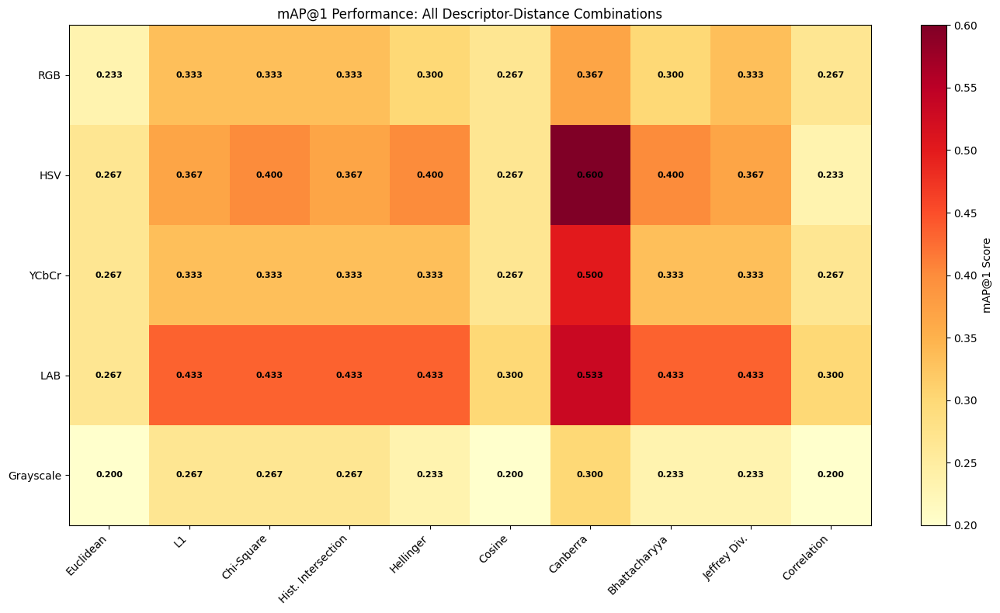

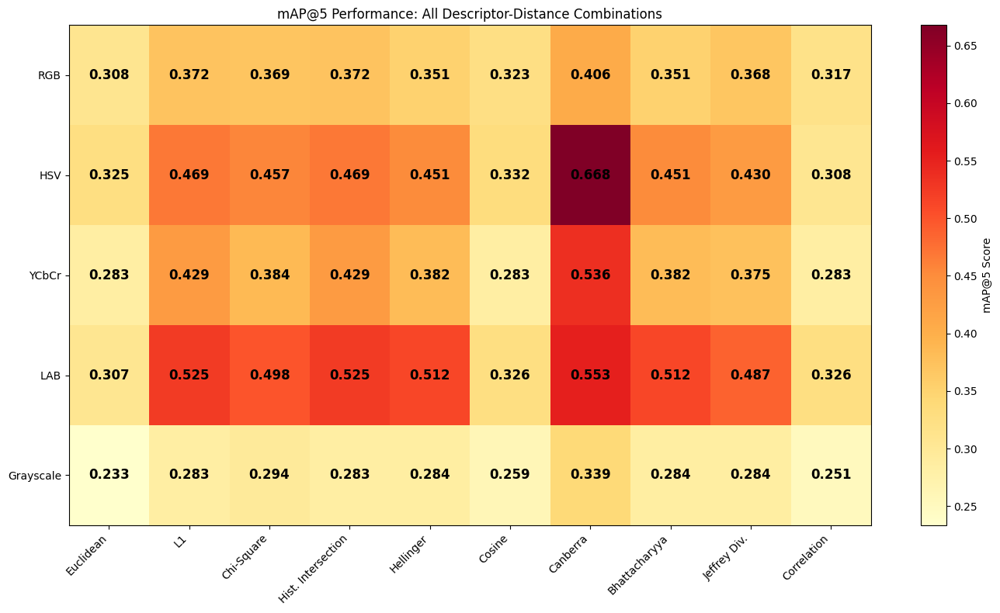

Building BBDD database (hsv, canberra_distance, bins_per_value=1)...


100%|██████████| 287/287 [00:22<00:00, 12.81it/s]


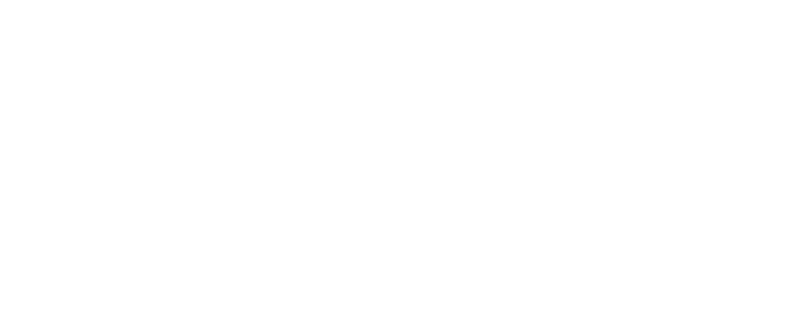

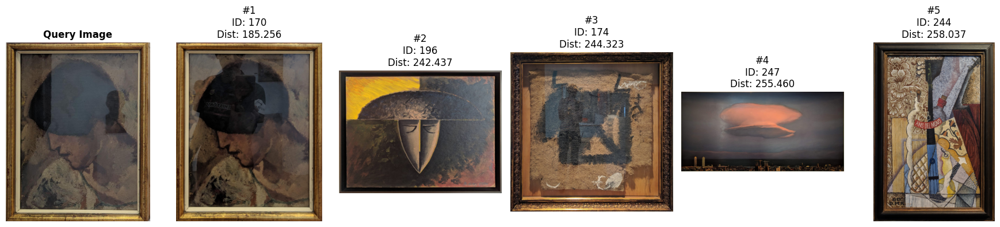

Query 1: GT=170, Retrieved=[170, 196, 174, 247, 244], Top-1 Correct=True


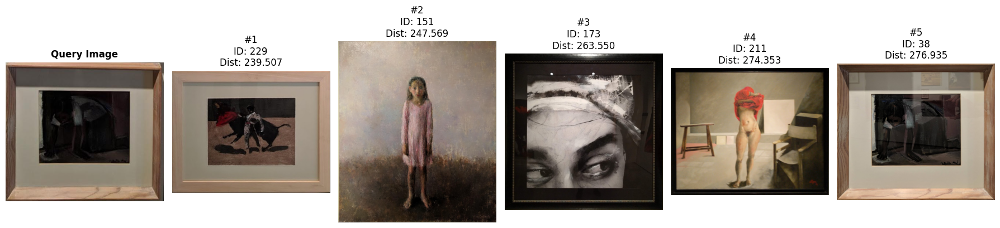

Query 25: GT=38, Retrieved=[229, 151, 173, 211, 38], Top-1 Correct=False


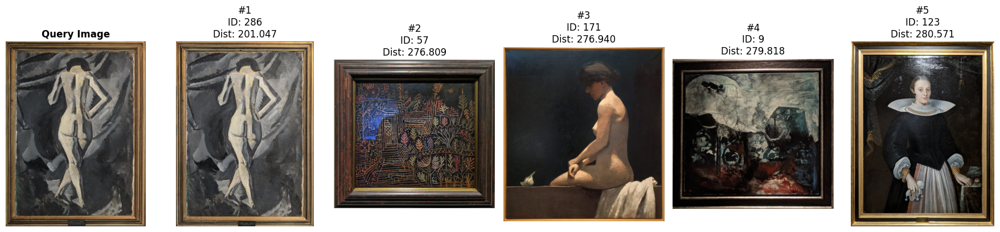

Query 18: GT=286, Retrieved=[286, 57, 171, 9, 123], Top-1 Correct=True


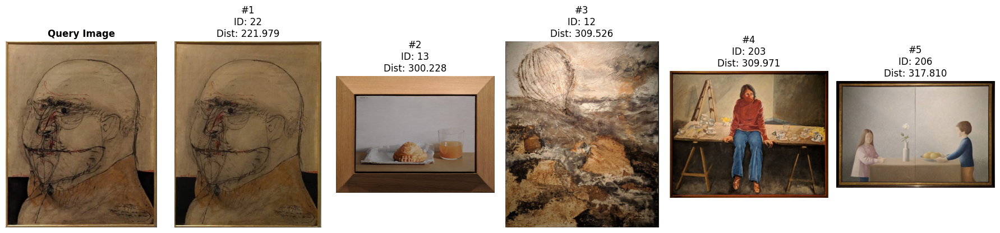

Query 11: GT=22, Retrieved=[22, 13, 12, 203, 206], Top-1 Correct=True


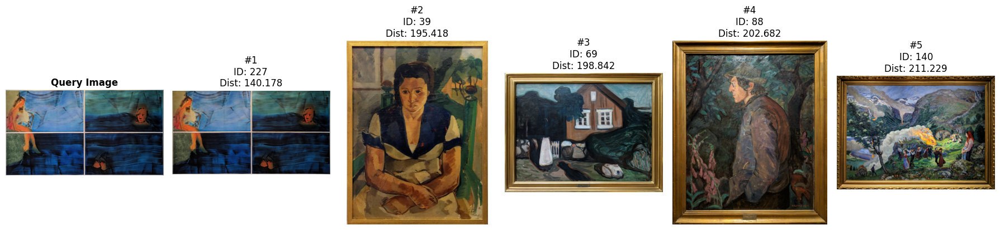

Query 3: GT=227, Retrieved=[227, 39, 69, 88, 140], Top-1 Correct=True


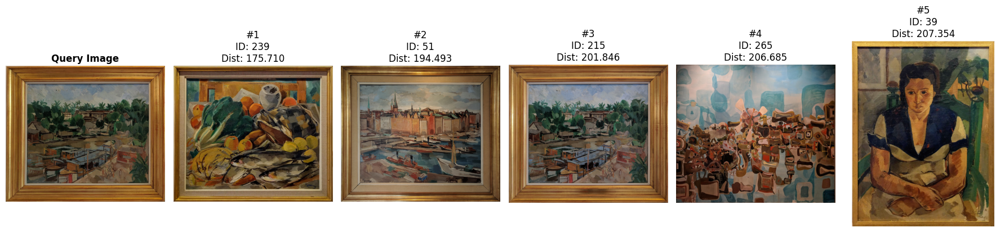

Query 19: GT=215, Retrieved=[239, 51, 215, 265, 39], Top-1 Correct=False


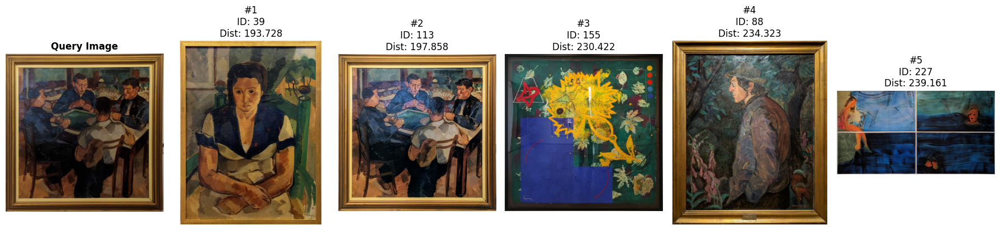

Query 12: GT=113, Retrieved=[39, 113, 155, 88, 227], Top-1 Correct=False


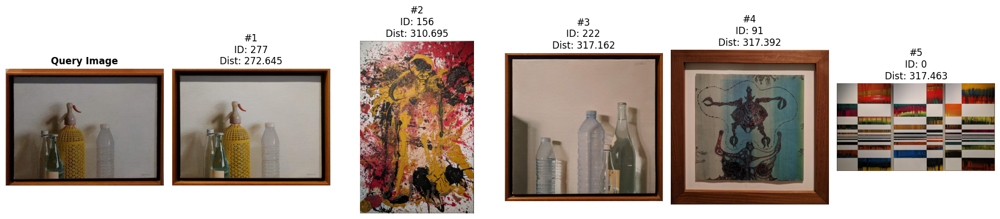

Query 2: GT=277, Retrieved=[277, 156, 222, 91, 0], Top-1 Correct=True


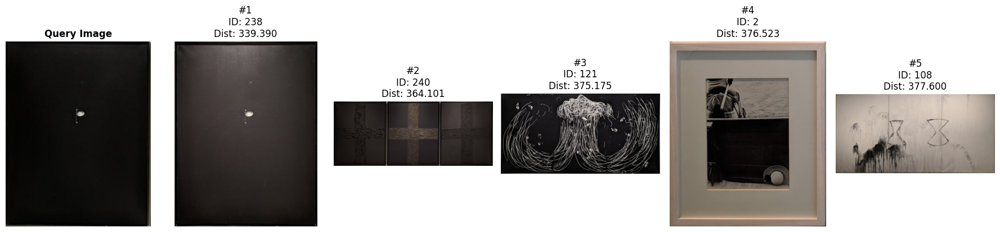

Query 26: GT=238, Retrieved=[238, 240, 121, 2, 108], Top-1 Correct=True


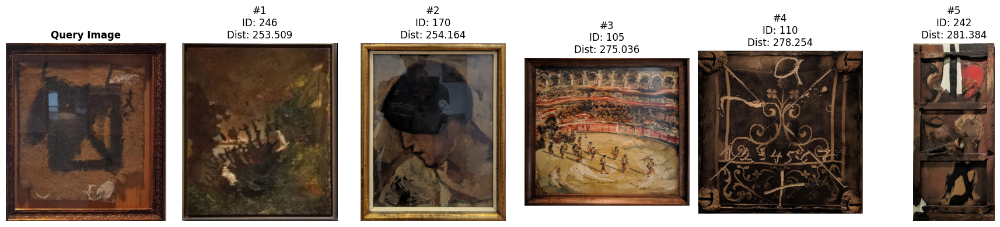

Query 14: GT=174, Retrieved=[246, 170, 105, 110, 242], Top-1 Correct=False


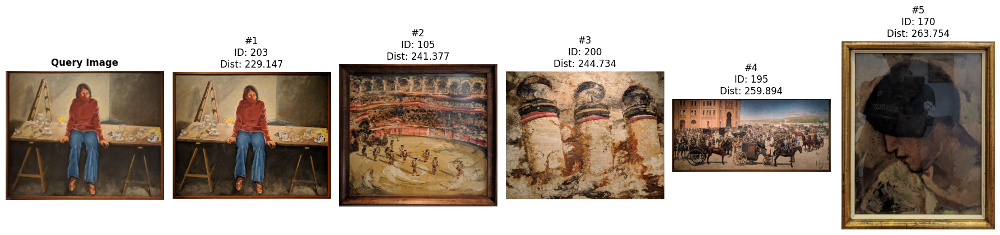

Query 9: GT=203, Retrieved=[203, 105, 200, 195, 170], Top-1 Correct=True


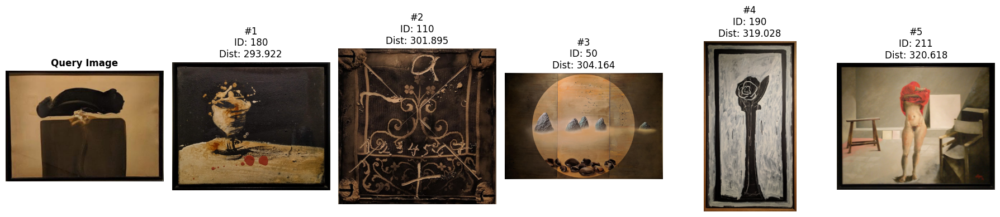

Query 6: GT=285, Retrieved=[180, 110, 50, 190, 211], Top-1 Correct=False


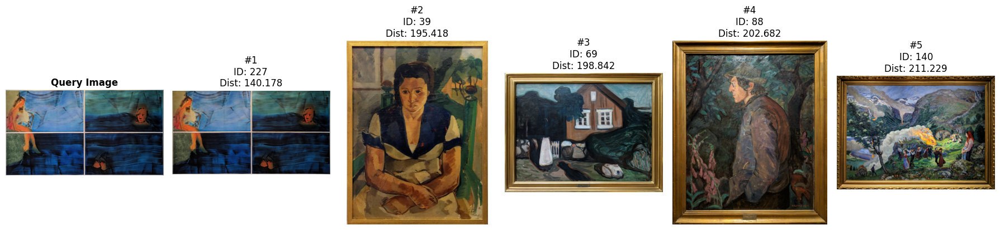

Query 3: GT=227, Retrieved=[227, 39, 69, 88, 140], Top-1 Correct=True


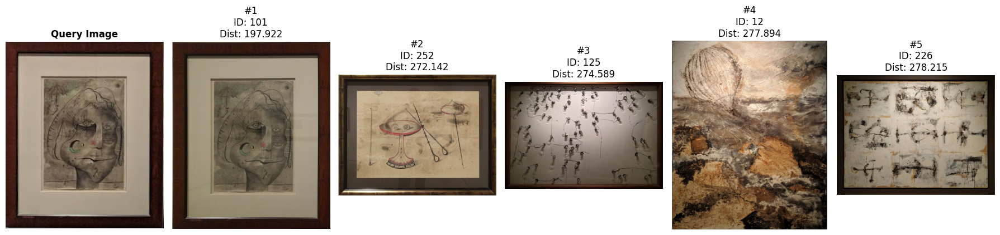

Query 13: GT=101, Retrieved=[101, 252, 125, 12, 226], Top-1 Correct=True


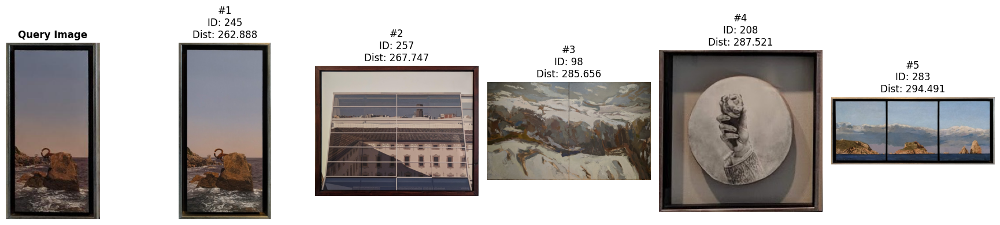

Query 21: GT=245, Retrieved=[245, 257, 98, 208, 283], Top-1 Correct=True


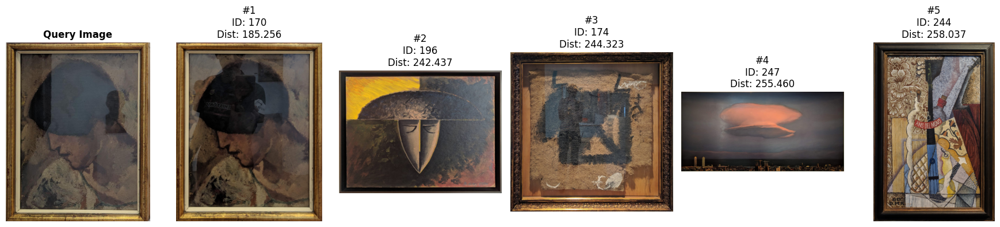

Query 1: GT=170, Retrieved=[170, 196, 174, 247, 244], Top-1 Correct=True


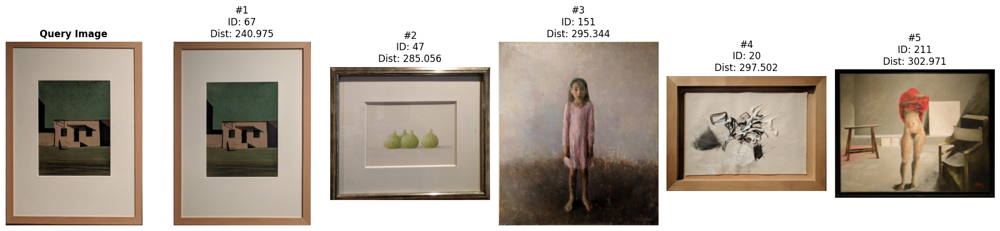

Query 27: GT=67, Retrieved=[67, 47, 151, 20, 211], Top-1 Correct=True


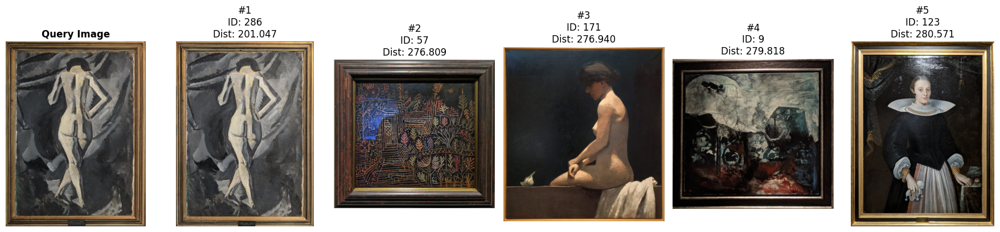

Query 18: GT=286, Retrieved=[286, 57, 171, 9, 123], Top-1 Correct=True


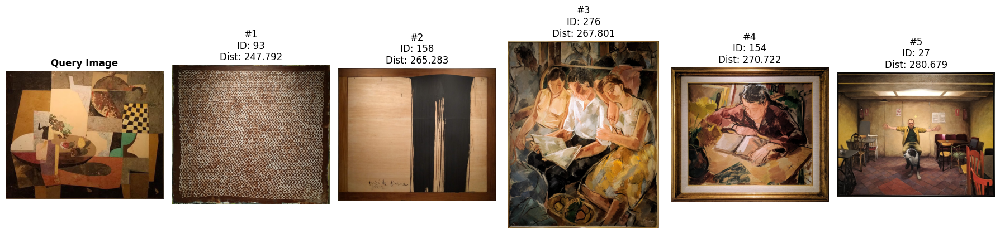

Query 28: GT=86, Retrieved=[93, 158, 276, 154, 27], Top-1 Correct=False


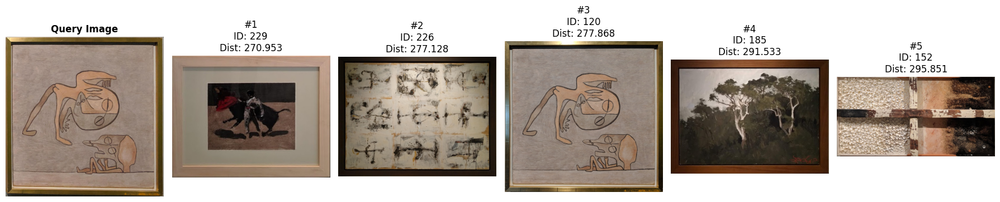

Query 0: GT=120, Retrieved=[229, 226, 120, 185, 152], Top-1 Correct=False


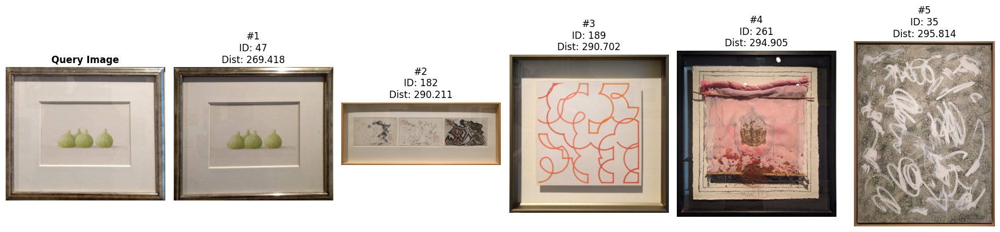

Query 17: GT=47, Retrieved=[47, 182, 189, 261, 35], Top-1 Correct=True


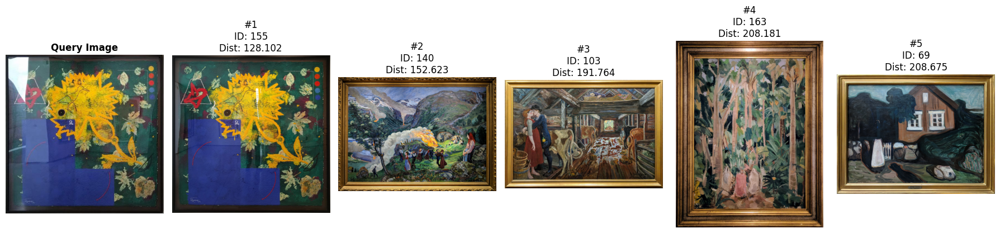

Query 15: GT=155, Retrieved=[155, 140, 103, 163, 69], Top-1 Correct=True


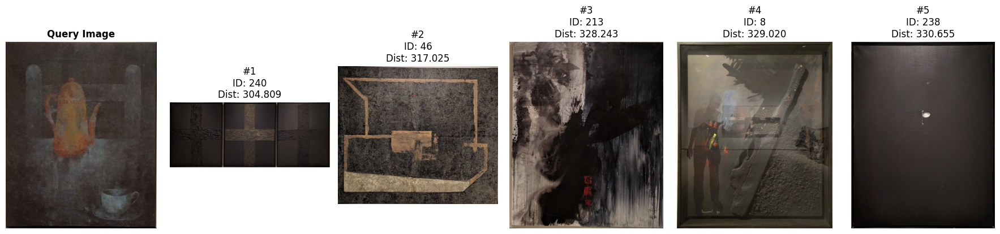

Query 5: GT=274, Retrieved=[240, 46, 213, 8, 238], Top-1 Correct=False


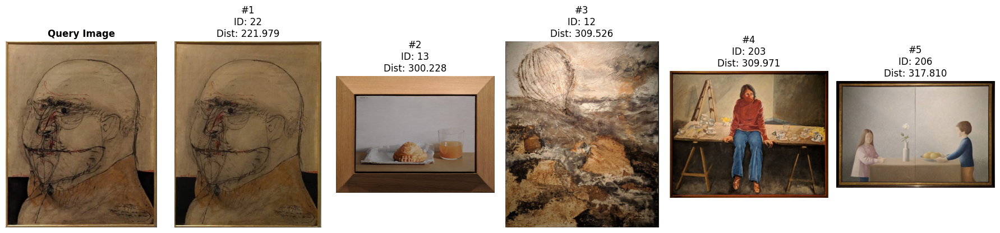

Query 11: GT=22, Retrieved=[22, 13, 12, 203, 206], Top-1 Correct=True


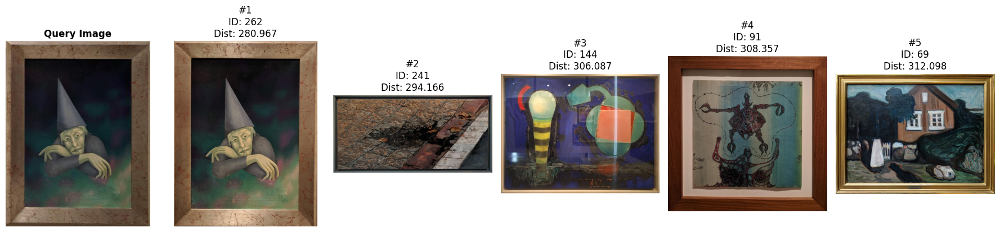

Query 24: GT=262, Retrieved=[262, 241, 144, 91, 69], Top-1 Correct=True


In [7]:
if __name__ == "__main__":
    QSD1_DIR = "/home/kunal/My Space/MCV/C1/Datasets/qsd1_w1"
    BBDD_DIR = "/home/kunal/My Space/MCV/C1/Datasets/BBDD"
    GROUND_TRUTH_PICKLE = "/home/kunal/My Space/MCV/C1/Datasets/qsd1_w1/gt_corresps.pkl"

    # values_per_bin=1 creates 256 bins, values_per_bin=2 creates 128 bins, etc.
    VALUES_PER_BIN = 1
    
    all_results, best_desc, best_dist, best_score = generate_comprehensive_analysis(
        QSD1_DIR, BBDD_DIR, GROUND_TRUTH_PICKLE, 
        values_per_bin=VALUES_PER_BIN
    )